In [75]:
import os
import sys
from tqdm import tqdm

import h5py
import yaml
import torch
import random
import numpy as np
from ema_pytorch import EMA
import matplotlib.pyplot as plt
from denoising_diffusion_pytorch import Unet

sys.path.append('../../tta_uia_segmentation/src/')

from models import ConditionalGaussianDiffusion


# Load the data

In [2]:
ds_fp = '/scratch_net/biwidl319/jbermeo/logs/brain/preprocessing/hcp_t1/data_T1_2d_size_256_256_depth_256_res_0.7_0.7_from_0_to_20.hdf_normalized_with_nn.h5'
ds_h5 = h5py.File(ds_fp, 'r')

img_size = 256
n_classes = 15
vol_idx = random.randint(0, int(ds_h5['images'].shape[0]/img_size))
slice_idx = random.randint(int(0.2 * img_size), int(0.8 * img_size))
rand_img = ds_h5['images'][vol_idx * img_size + slice_idx, :, :]
seg = ds_h5['labels'][vol_idx * img_size + slice_idx, :, :]
seg = seg 

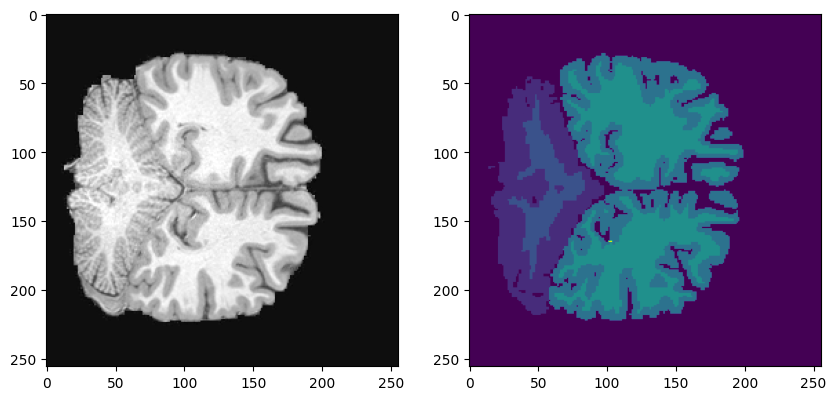

In [3]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(rand_img, cmap='gray')
ax[1].imshow(seg, cmap='viridis')
plt.show()

# Check how the noise sampling looks like

In [4]:
denoise_model = Unet(
    dim = 16,
    dim_mults = (1, 2),   
    flash_attn = True,
    channels= 1, 
    self_condition=True,
)#.to(device)

ddpm = ConditionalGaussianDiffusion(
    denoise_model,
    image_size=img_size
)

/itet-stor/jbermeo/net_scratch/conda_envs/ddpm/lib/python3.10/site-packages/torch/cuda/__init__.py:138: UserWarning: CUDA initialization: The NVIDIA driver on your system is too old (found version 10010). Please update your GPU driver by downloading and installing a new version from the URL: http://www.nvidia.com/Download/index.aspx Alternatively, go to: https://pytorch.org to install a PyTorch version that has been compiled with your version of the CUDA driver. (Triggered internally at /opt/conda/conda-bld/pytorch_1695392020201/work/c10/cuda/CUDAFunctions.cpp:108.)
  return torch._C._cuda_getDeviceCount() > 0


In [5]:
t = 150
t = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(rand_img, t, noise)

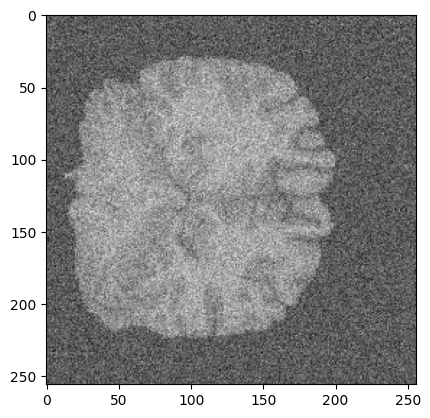

In [6]:
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

# Behaviour in a trained model

### Load the checkpointed model

In [7]:
run_params = yaml.safe_load(
    open('/scratch_net/biwidl319/jbermeo/logs/brain/cddpm/params.yaml', 'r'))
cpt_path = '/scratch_net/biwidl319/jbermeo/logs/brain/cddpm/model-64.pt'

In [8]:
train_config = run_params['training']['ddpm']

timesteps           = train_config['timesteps']
sampling_timesteps  = train_config['sampling_timesteps']

# Model definition
model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),   
    flash_attn = True,
    channels=1, 
    self_condition=True,
)#.to(device)

ddpm = ConditionalGaussianDiffusion(
    model,
    image_size = 256,
    timesteps = timesteps,    # Range of steps in diffusion process
    sampling_timesteps = sampling_timesteps 
)

In [9]:
cpt = torch.load(cpt_path, map_location='cpu')

In [10]:
cpt.keys()

dict_keys(['step', 'model', 'opt', 'ema', 'scaler', 'version'])

In [11]:
ddpm.load_state_dict(cpt['model'])

<All keys matched successfully>

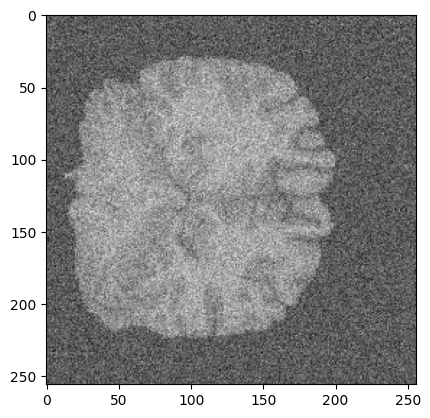

In [12]:
ema_update_every = 10
ema_decay = 0.995
ddpm_ema = EMA(ddpm, beta = ema_decay, update_every = ema_update_every)
ddpm_ema.load_state_dict(cpt['ema'])
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

## How does the denoising inference function look like

## How does slight noising and denoising look like

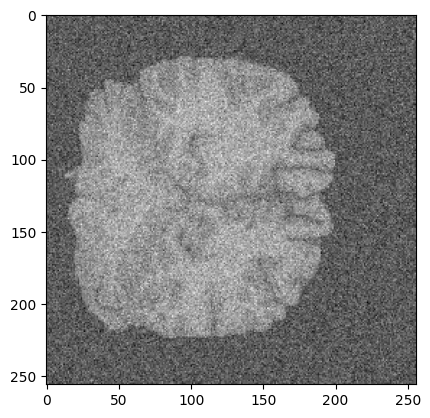

In [91]:
t = 150
t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(rand_img, t_tch, noise)
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

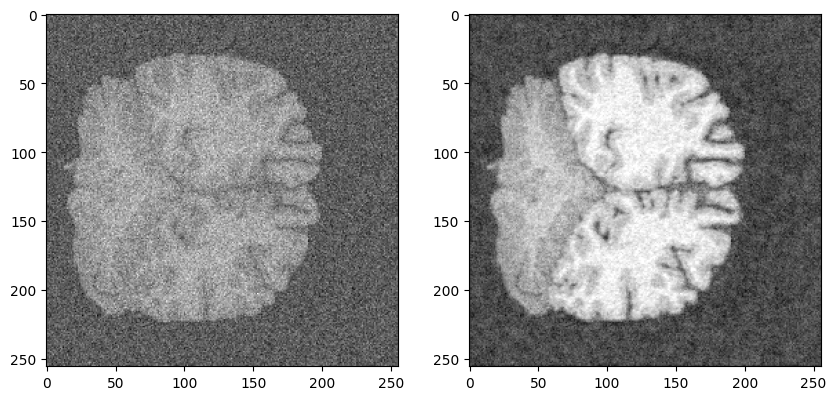

In [92]:
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
img_denoised, v_est = ddpm_ema.model.p_sample(noised_img, t, x_cond)

# Plot them side by side
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(img_denoised.squeeze().numpy(), cmap='gray')
ax[1].imshow(v_est.squeeze().numpy(), cmap='gray')
plt.show()

sampling loop time step:  16%|█▌        | 24/150 [00:16<01:33,  1.34it/s]

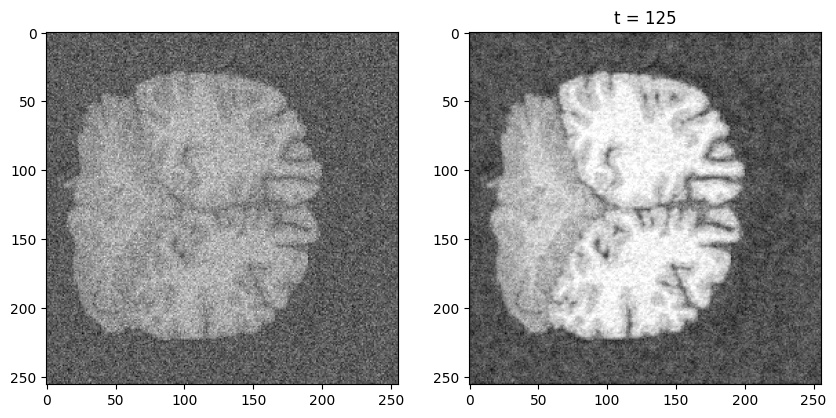

sampling loop time step:  33%|███▎      | 49/150 [00:34<01:10,  1.44it/s]

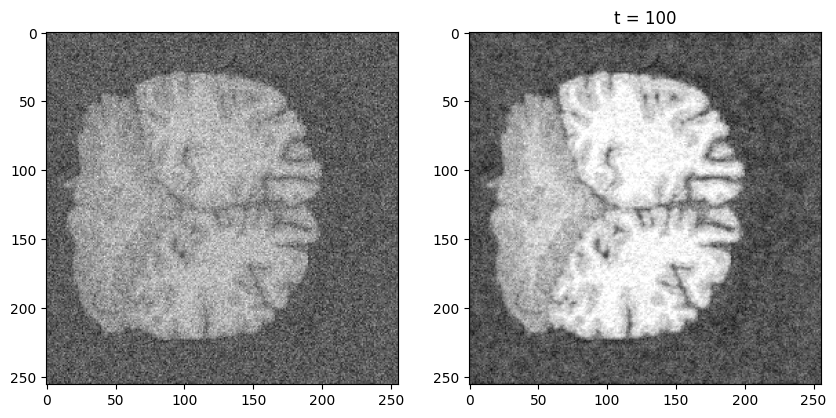

sampling loop time step:  49%|████▉     | 74/150 [00:54<00:57,  1.33it/s]

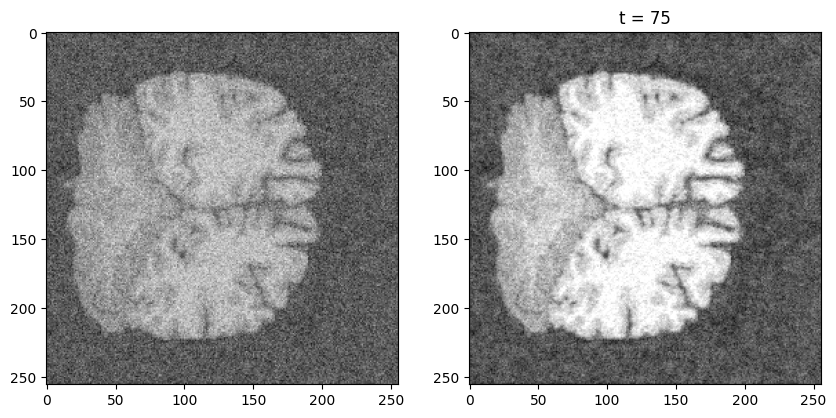

sampling loop time step:  66%|██████▌   | 99/150 [01:14<00:43,  1.17it/s]

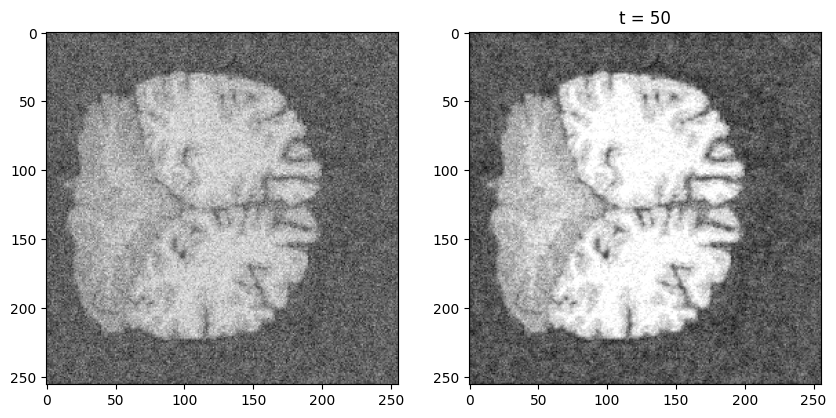

sampling loop time step:  83%|████████▎ | 124/150 [01:35<00:20,  1.24it/s]

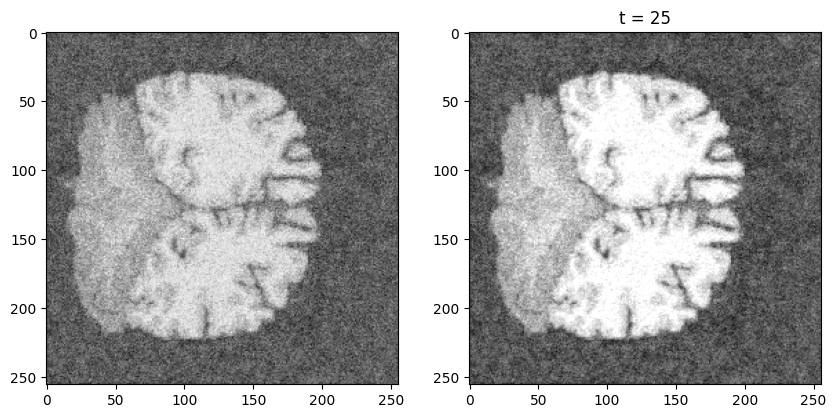

sampling loop time step:  99%|█████████▉| 149/150 [01:54<00:00,  1.32it/s]

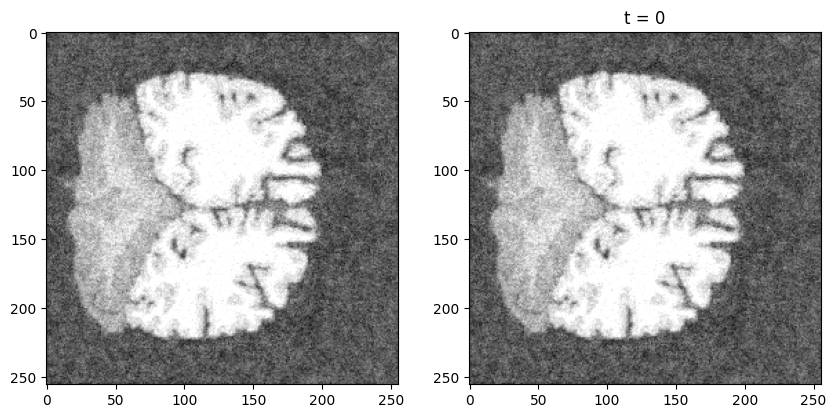

sampling loop time step: 100%|██████████| 150/150 [01:55<00:00,  1.29it/s]


In [93]:
plot_every = 25
img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised, v_est = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img_denoised.squeeze().numpy(), cmap='gray')
        ax[1].imshow(v_est.squeeze().numpy(), cmap='gray')
        plt.title('t = {}'.format(t_i))
        plt.show()

### Let's try with very little noise

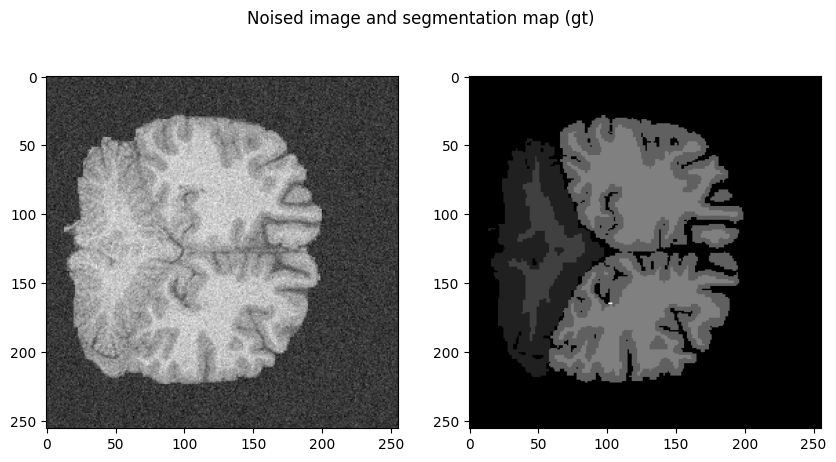

sampling loop time step:   0%|          | 0/25 [00:00<?, ?it/s]

sampling loop time step:  12%|█▏        | 3/25 [00:03<00:22,  1.03s/it]

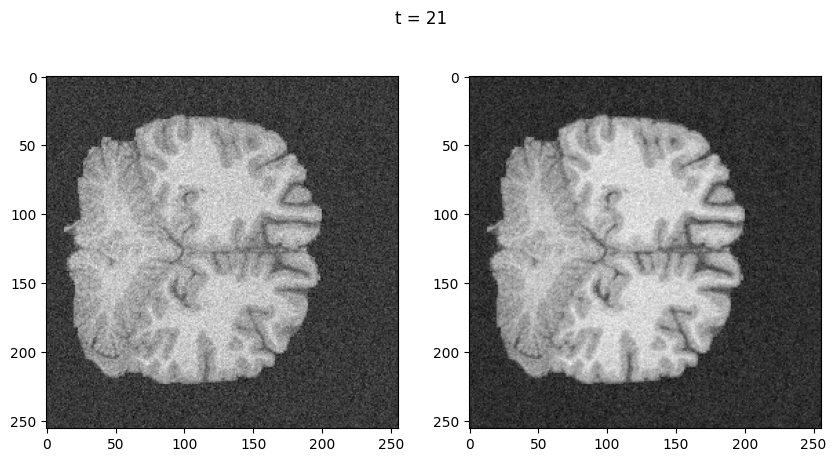

sampling loop time step:  40%|████      | 10/25 [00:12<00:19,  1.30s/it]

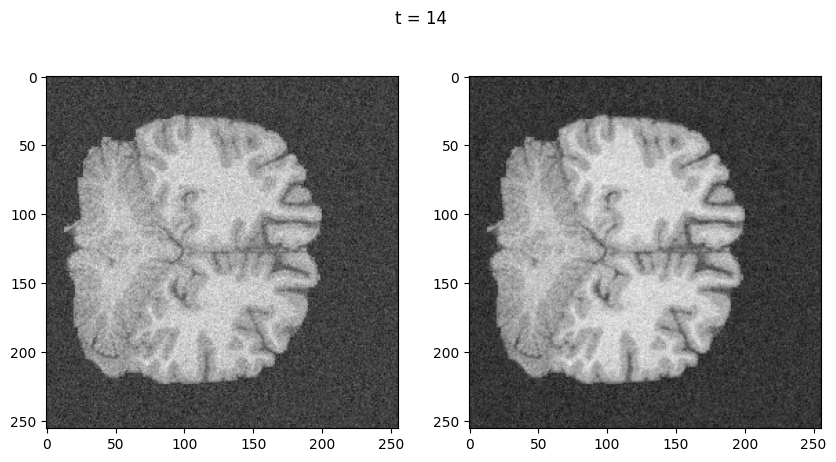

sampling loop time step:  68%|██████▊   | 17/25 [00:20<00:10,  1.35s/it]

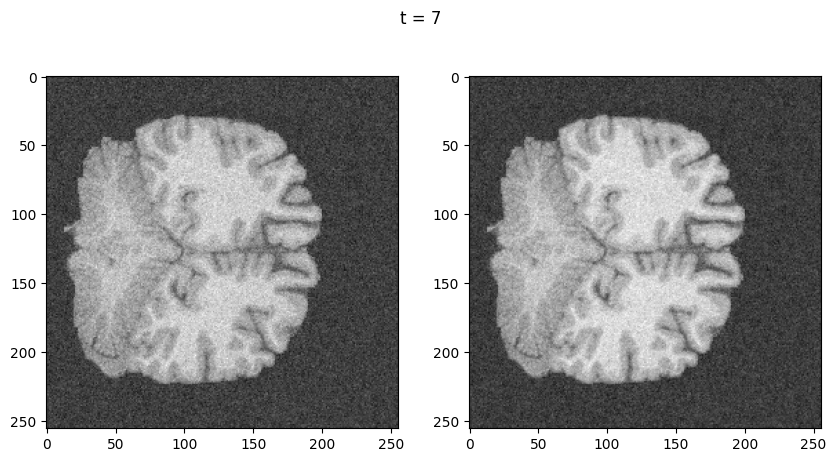

sampling loop time step:  96%|█████████▌| 24/25 [00:29<00:01,  1.17s/it]

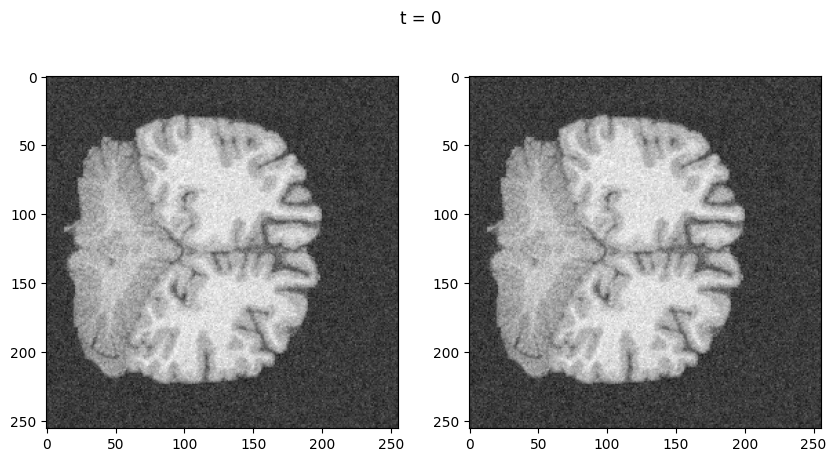

sampling loop time step: 100%|██████████| 25/25 [00:30<00:00,  1.23s/it]


In [114]:
t = 25
plot_every = 7

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(rand_img, t_tch, noise)

# Plot inputs side by side
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(noised_img.squeeze().numpy(), cmap='gray')
ax[1].imshow(seg, cmap='gray')
plt.suptitle('Noised image and segmentation map (gt)')
plt.show()

img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised, v_est = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img_denoised.squeeze().numpy(), cmap='gray')
        ax[1].imshow(v_est.squeeze().numpy(), cmap='gray')
        plt.suptitle('t = {}'.format(t_i))
        plt.show()

### Let's try with a stronger noise

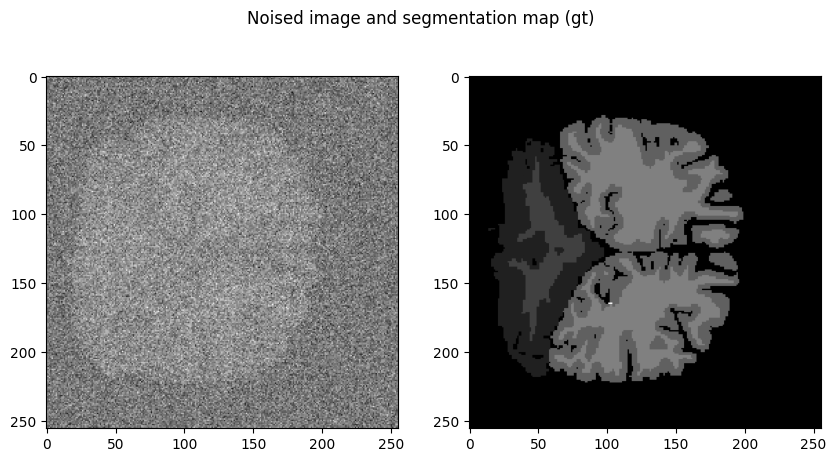

sampling loop time step:   0%|          | 1/500 [00:00<07:13,  1.15it/s]

sampling loop time step:   5%|▍         | 24/500 [00:17<05:32,  1.43it/s]

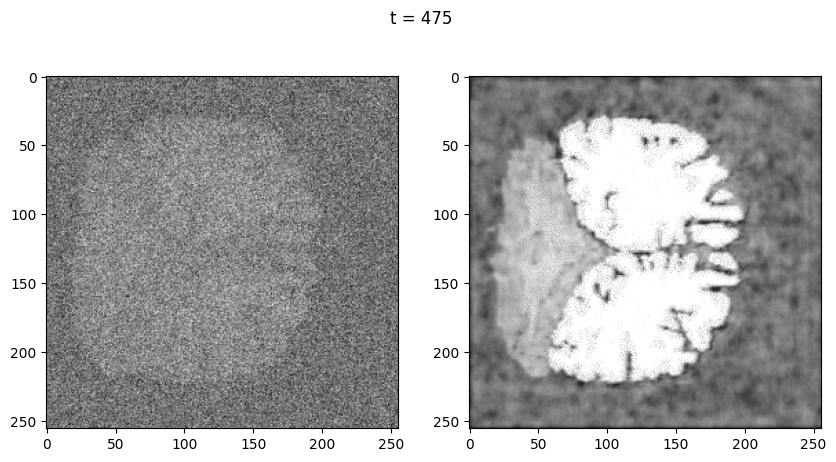

sampling loop time step:  10%|▉         | 49/500 [00:38<05:01,  1.50it/s]

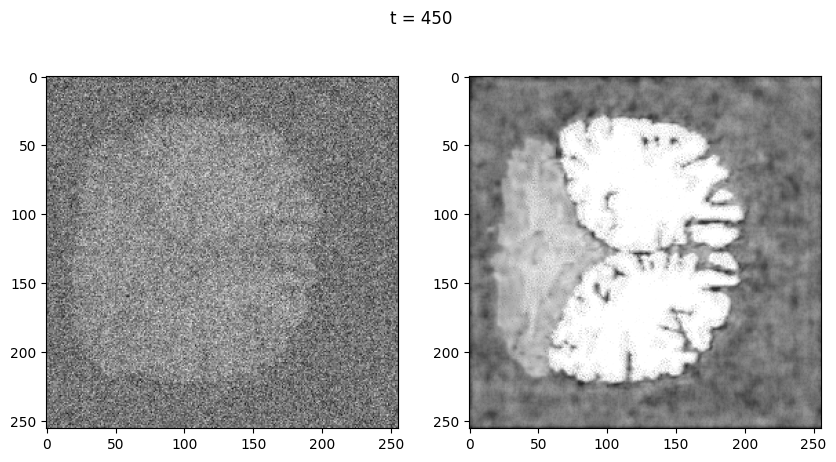

sampling loop time step:  15%|█▍        | 74/500 [00:55<04:54,  1.45it/s]

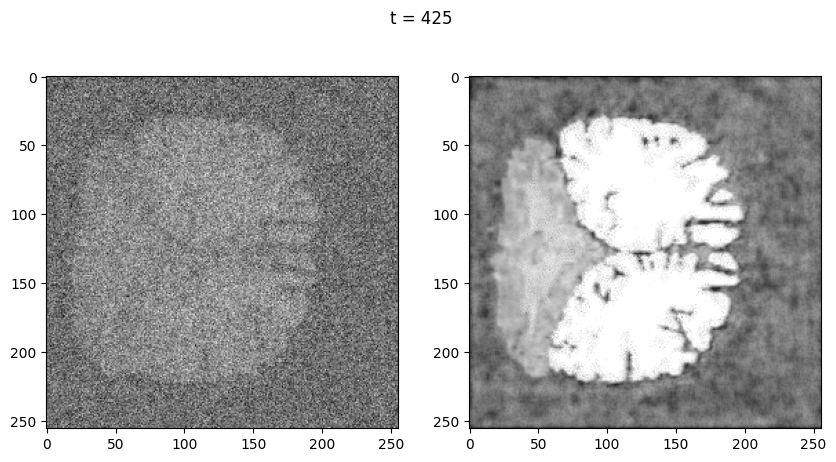

sampling loop time step:  20%|█▉        | 99/500 [01:12<04:33,  1.47it/s]

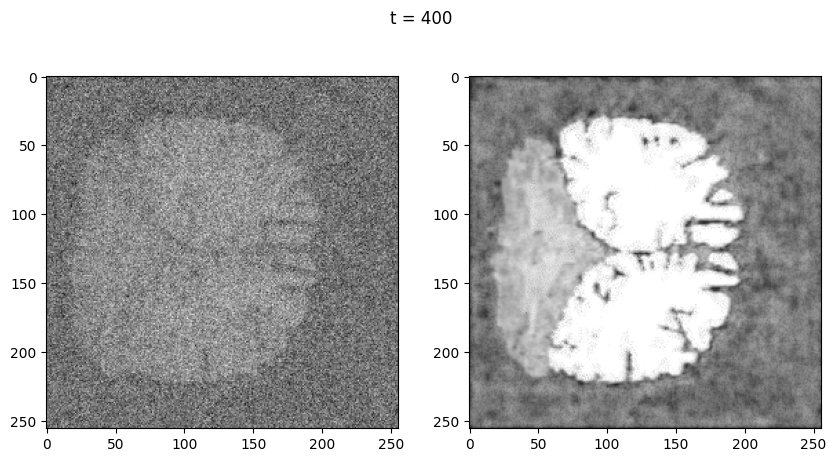

sampling loop time step:  25%|██▍       | 124/500 [01:31<04:36,  1.36it/s]

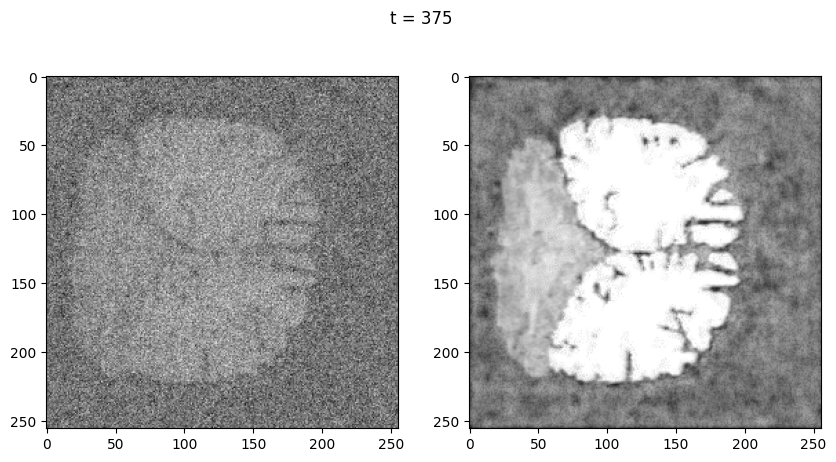

sampling loop time step:  30%|██▉       | 149/500 [01:51<04:18,  1.36it/s]

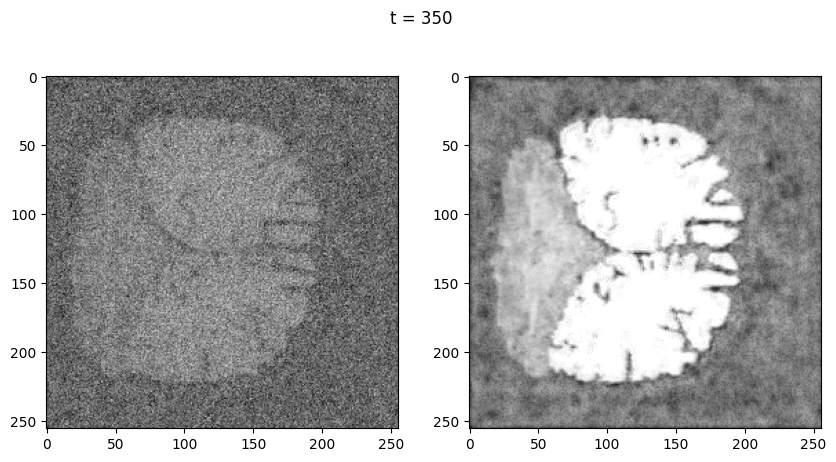

sampling loop time step:  35%|███▍      | 174/500 [02:11<03:58,  1.37it/s]

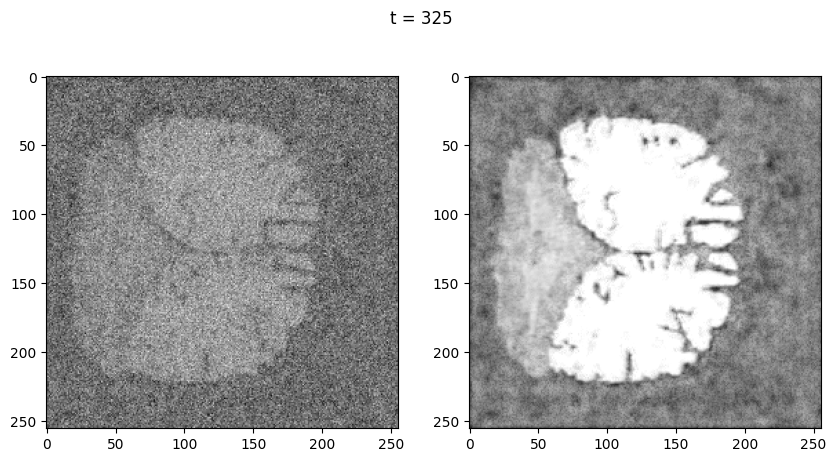

sampling loop time step:  40%|███▉      | 199/500 [02:29<03:56,  1.27it/s]

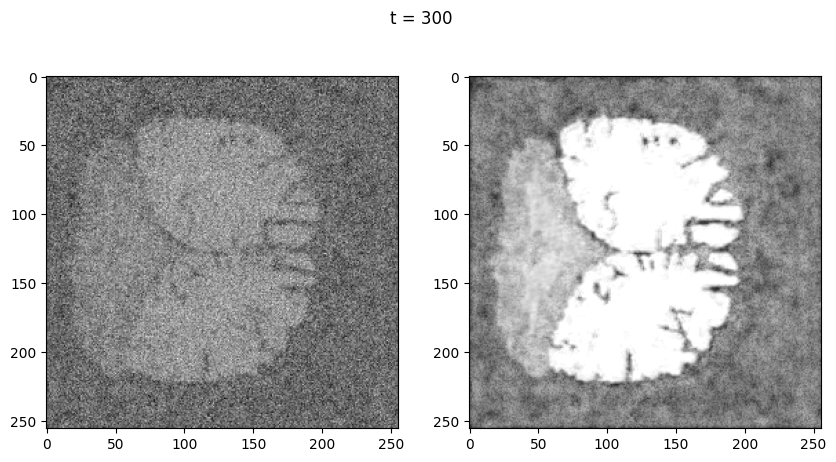

sampling loop time step:  45%|████▍     | 224/500 [02:47<03:03,  1.50it/s]

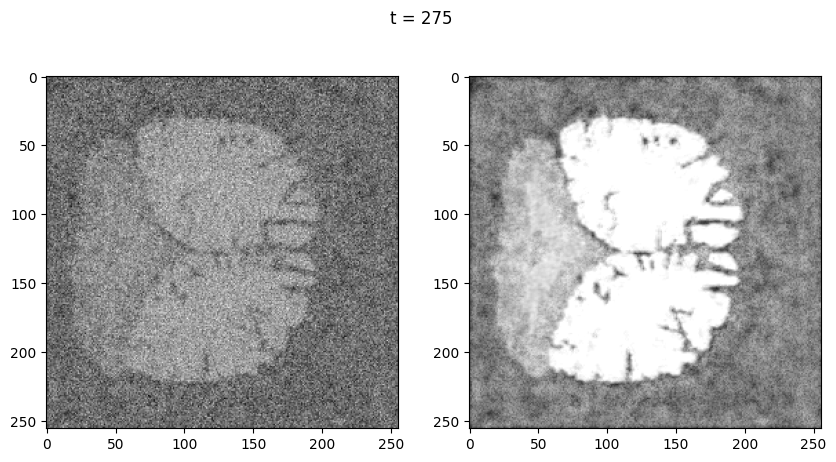

sampling loop time step:  50%|████▉     | 249/500 [03:03<02:50,  1.47it/s]

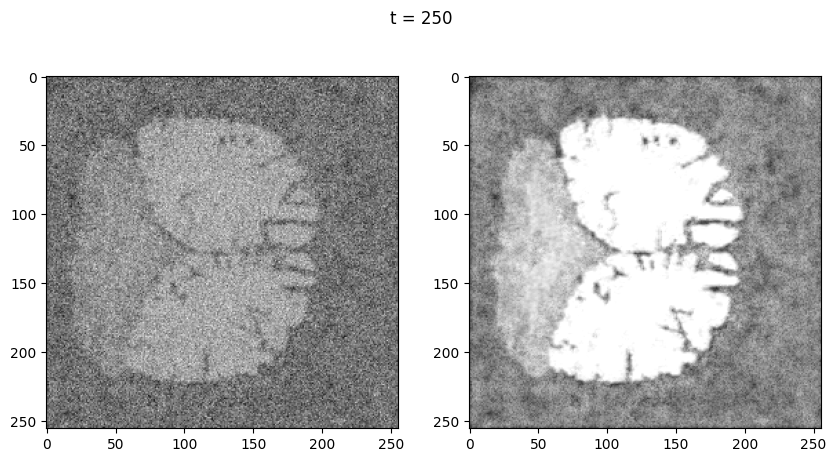

sampling loop time step:  55%|█████▍    | 274/500 [03:25<03:09,  1.19it/s]

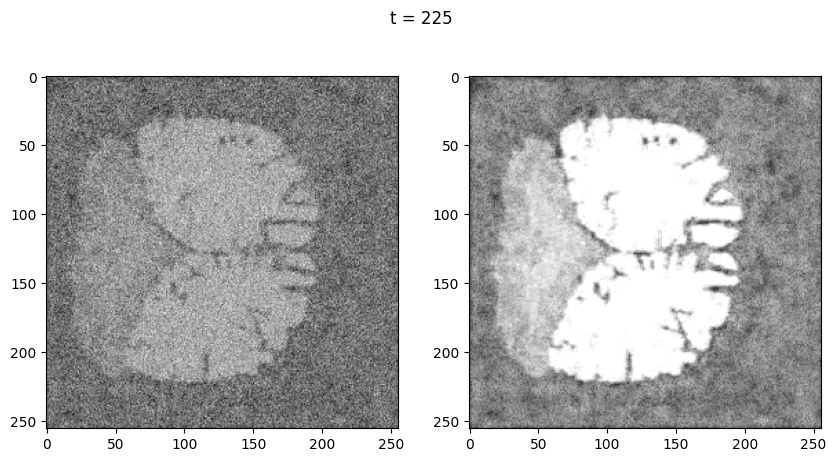

sampling loop time step:  60%|█████▉    | 299/500 [03:45<02:38,  1.27it/s]

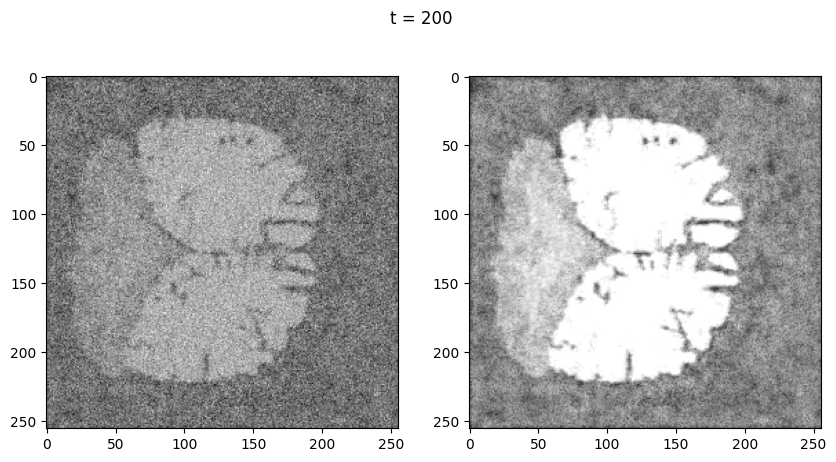

sampling loop time step:  65%|██████▍   | 324/500 [04:06<02:15,  1.30it/s]

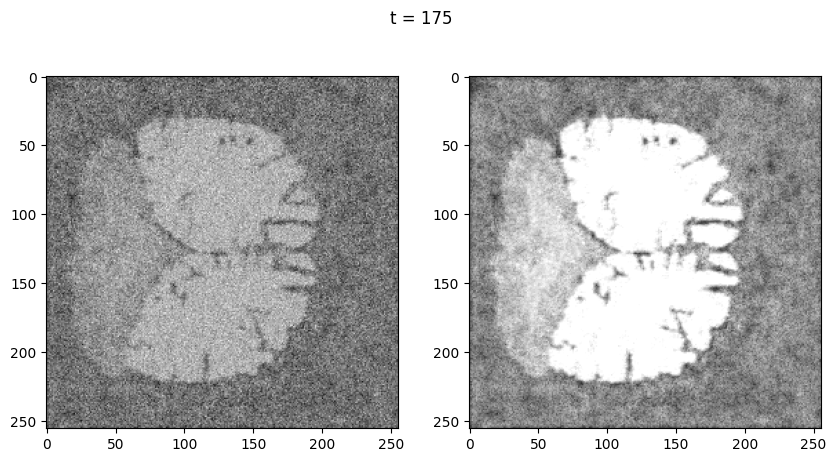

sampling loop time step:  70%|██████▉   | 349/500 [04:25<01:45,  1.43it/s]

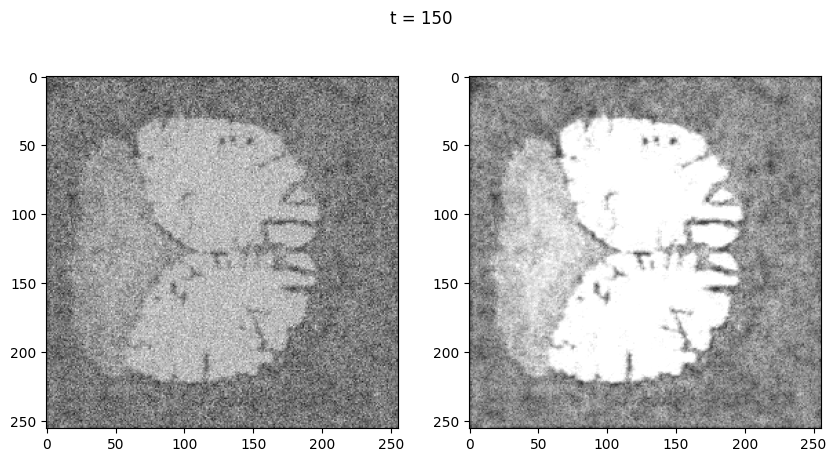

sampling loop time step:  75%|███████▍  | 374/500 [04:45<01:41,  1.24it/s]

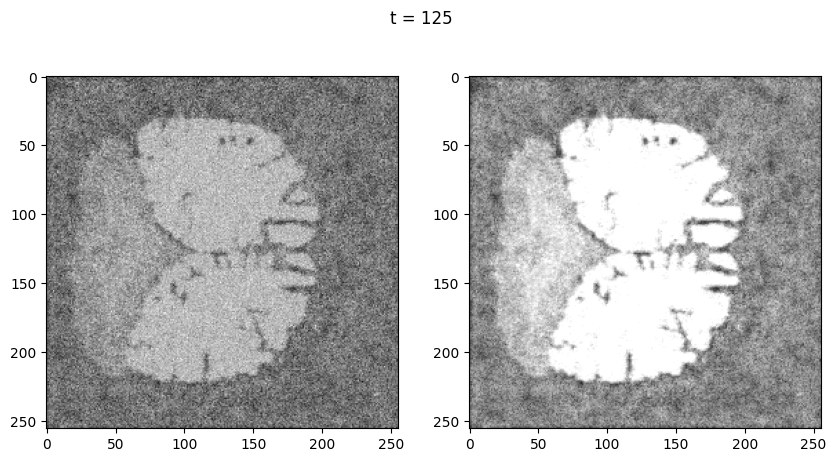

sampling loop time step:  80%|███████▉  | 399/500 [05:06<01:23,  1.21it/s]

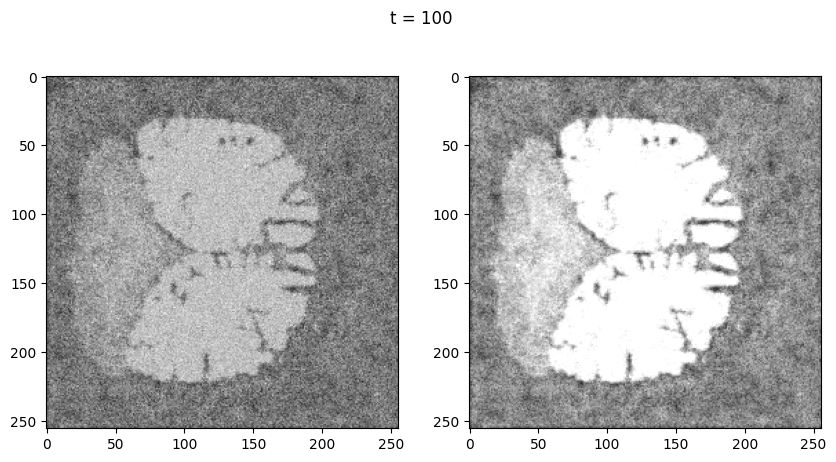

sampling loop time step:  85%|████████▍ | 424/500 [05:27<01:01,  1.23it/s]

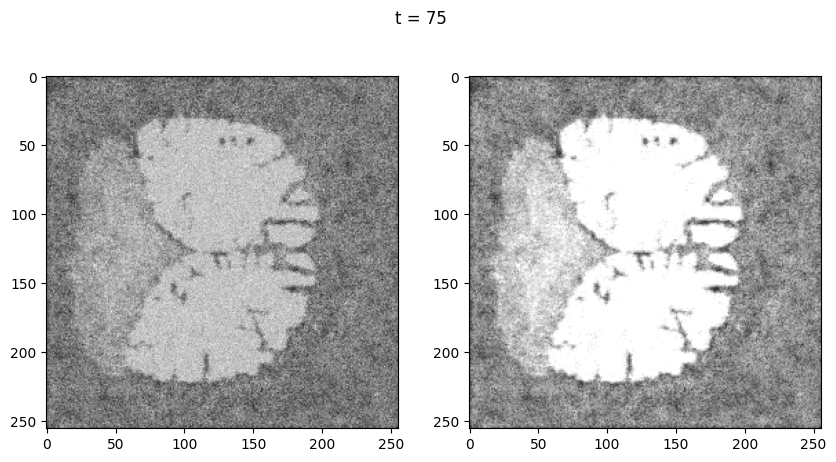

sampling loop time step:  90%|████████▉ | 449/500 [05:47<00:44,  1.16it/s]

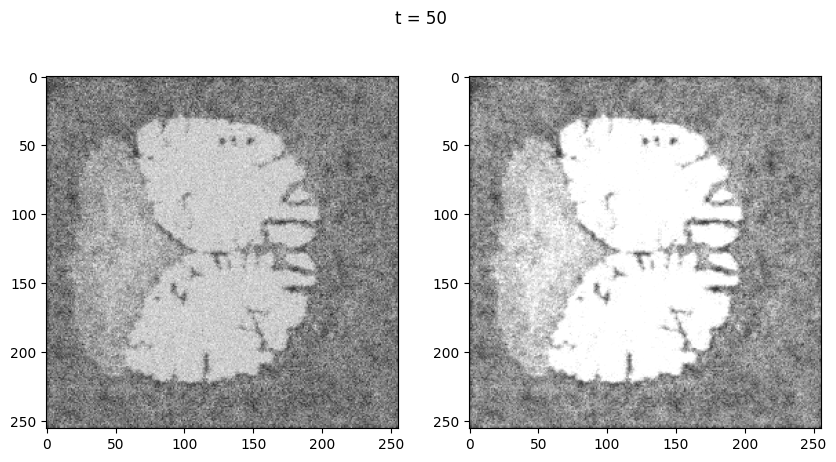

sampling loop time step:  95%|█████████▍| 474/500 [06:08<00:24,  1.07it/s]

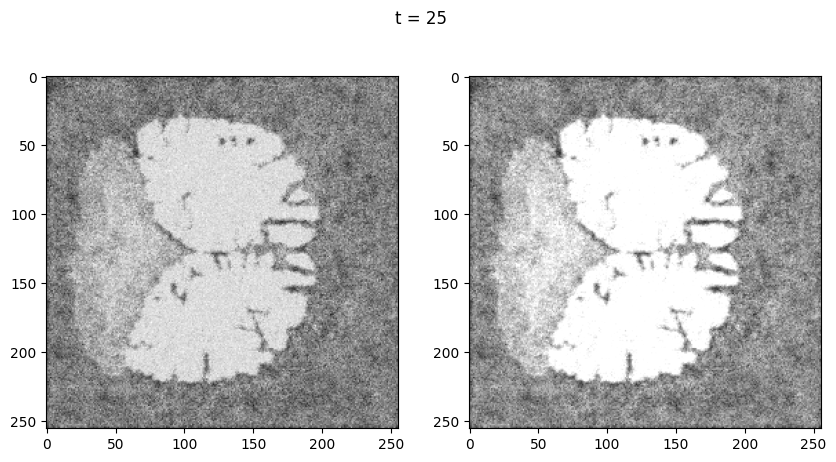

sampling loop time step: 100%|█████████▉| 499/500 [06:29<00:00,  1.17it/s]

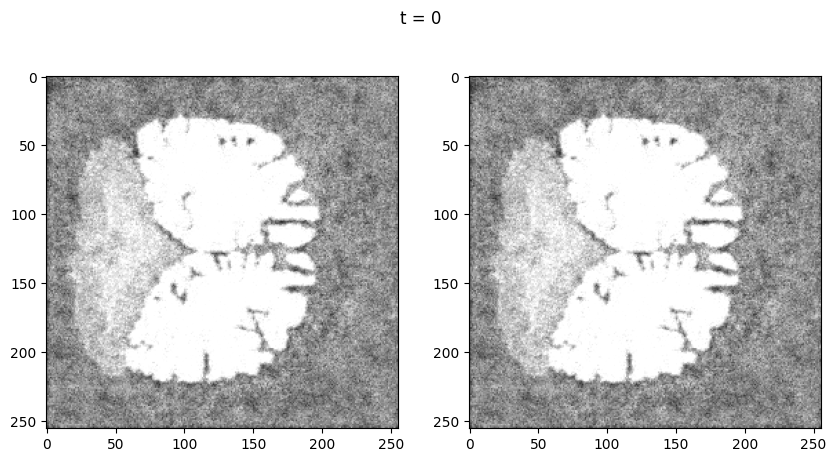

sampling loop time step: 100%|██████████| 500/500 [06:30<00:00,  1.28it/s]


In [94]:
t = 500
plot_every = 25

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(rand_img, t_tch, noise)

# Plot inputs side by side
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(noised_img.squeeze().numpy(), cmap='gray')
ax[1].imshow(seg, cmap='gray')
plt.suptitle('Noised image and segmentation map (gt)')
plt.show()

img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised, v_est = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img_denoised.squeeze().numpy(), cmap='gray')
        ax[1].imshow(v_est.squeeze().numpy(), cmap='gray')
        plt.suptitle('t = {}'.format(t_i))
        plt.show()

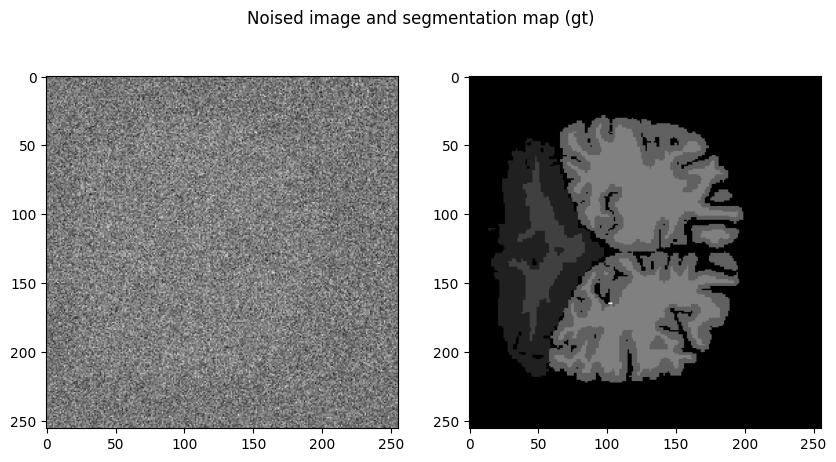

sampling loop time step:   0%|          | 4/800 [00:03<10:24,  1.28it/s]

sampling loop time step:   6%|▌         | 49/800 [00:37<09:32,  1.31it/s]

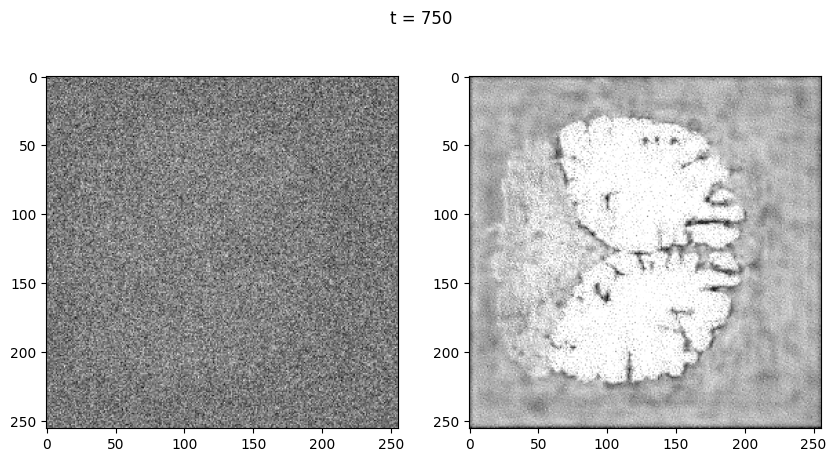

sampling loop time step:  12%|█▏        | 99/800 [01:17<09:33,  1.22it/s]

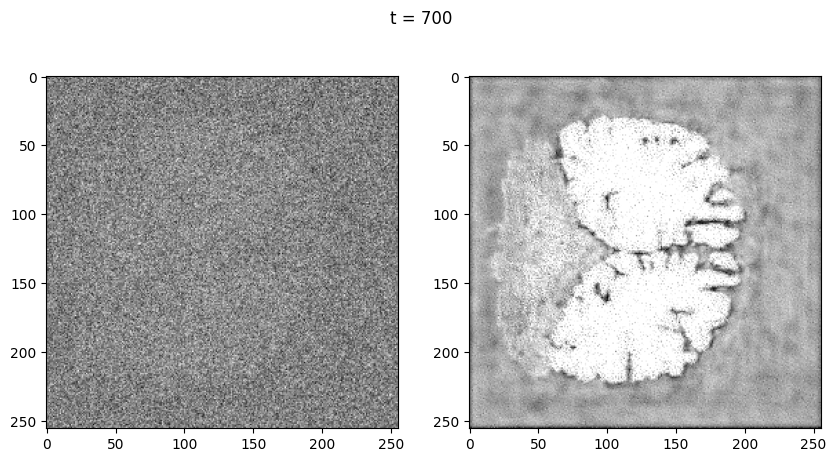

sampling loop time step:  19%|█▊        | 149/800 [01:57<08:03,  1.35it/s]

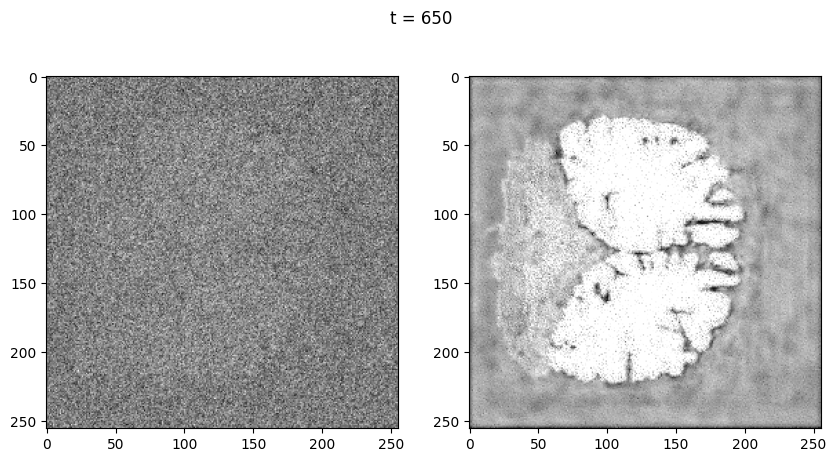

sampling loop time step:  25%|██▍       | 199/800 [02:37<07:57,  1.26it/s]

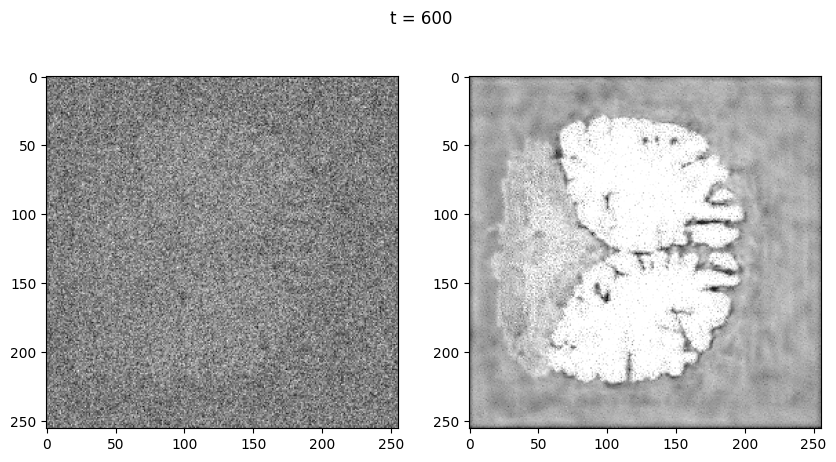

sampling loop time step:  31%|███       | 249/800 [03:18<07:35,  1.21it/s]

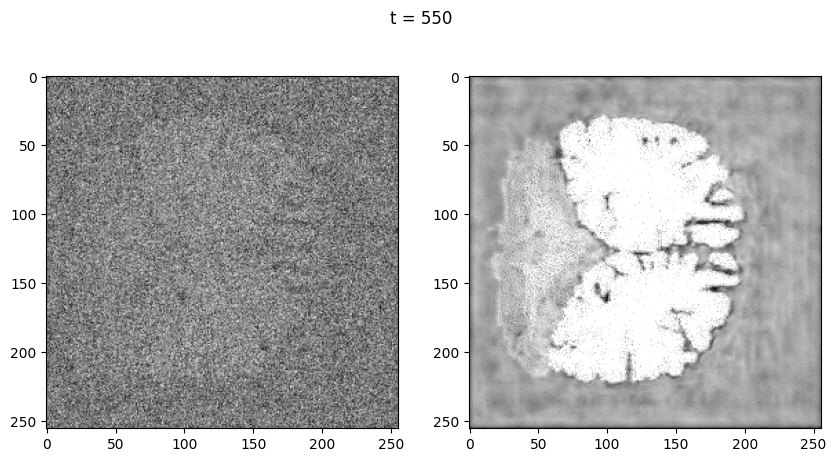

sampling loop time step:  37%|███▋      | 299/800 [03:58<06:18,  1.32it/s]

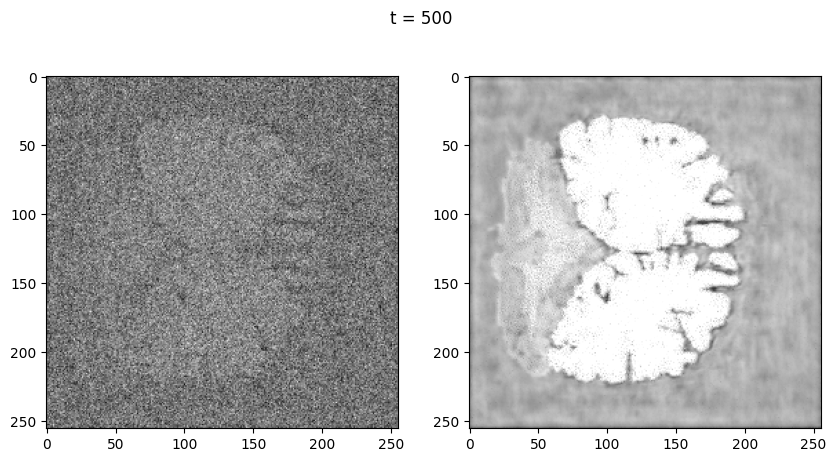

sampling loop time step:  44%|████▎     | 349/800 [04:38<05:27,  1.38it/s]

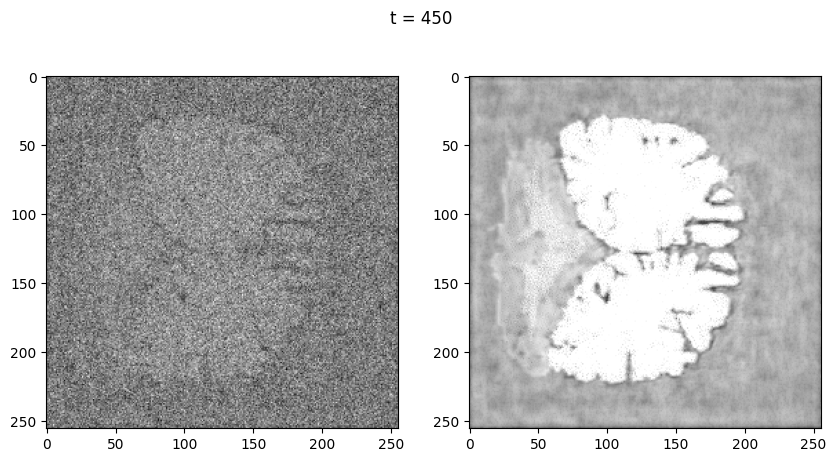

sampling loop time step:  50%|████▉     | 399/800 [05:25<05:51,  1.14it/s]

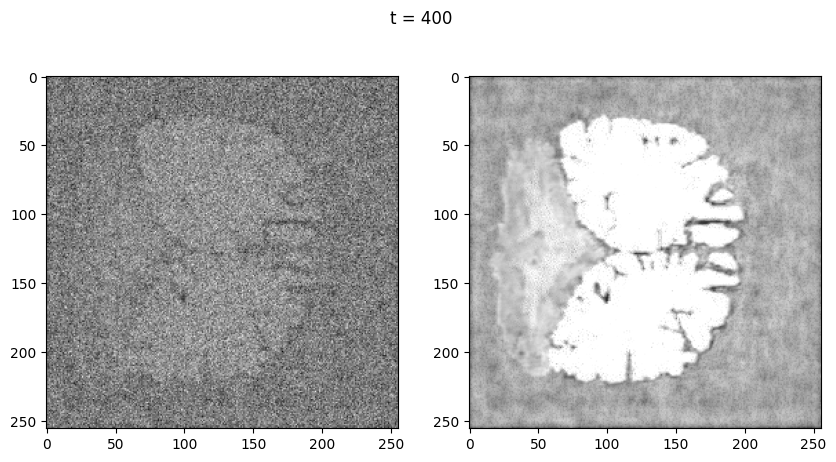

sampling loop time step:  56%|█████▌    | 449/800 [06:08<04:40,  1.25it/s]

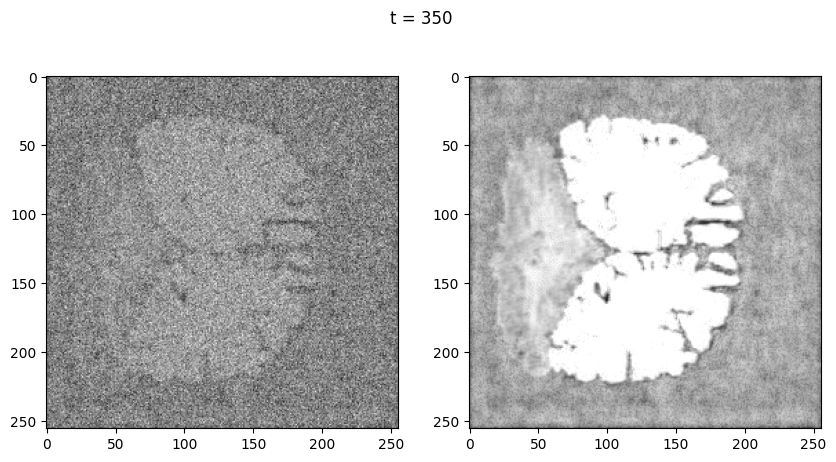

sampling loop time step:  62%|██████▏   | 499/800 [06:58<04:38,  1.08it/s]

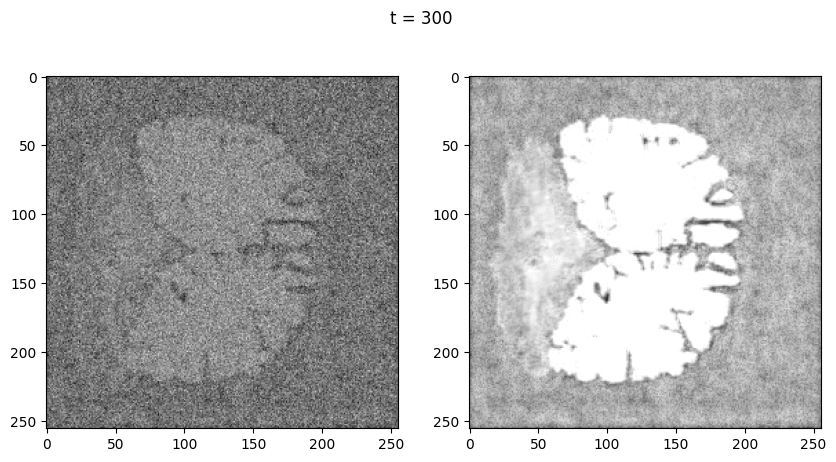

sampling loop time step:  69%|██████▊   | 549/800 [07:49<04:44,  1.13s/it]

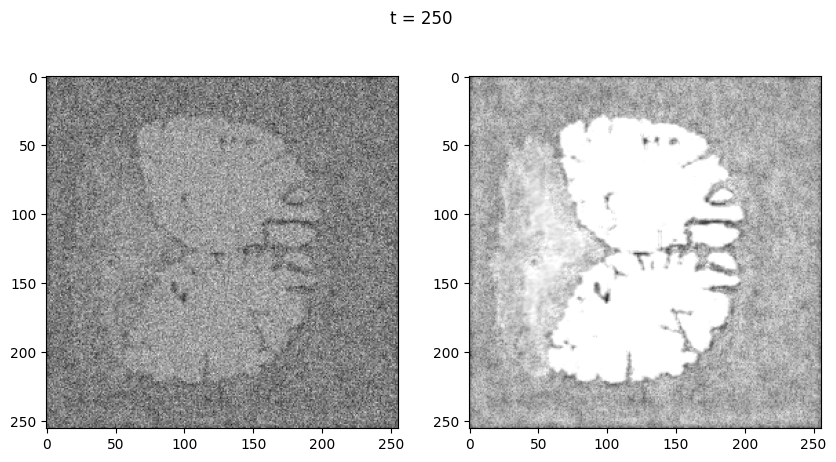

sampling loop time step:  75%|███████▍  | 599/800 [08:39<03:24,  1.02s/it]

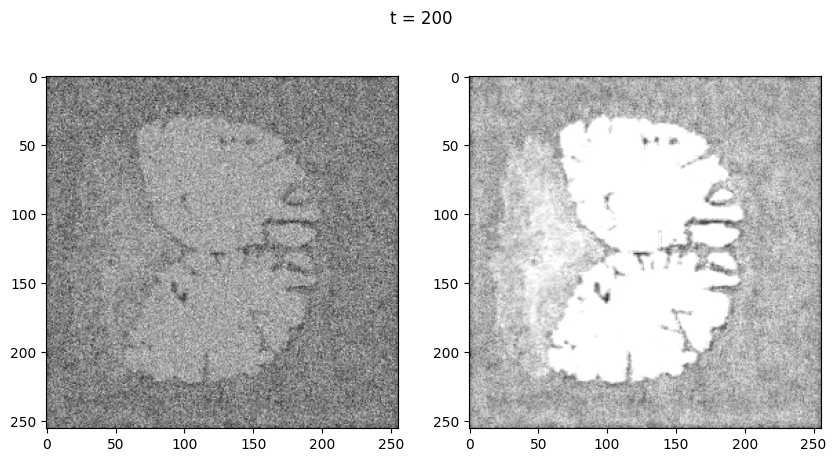

sampling loop time step:  81%|████████  | 649/800 [09:30<02:32,  1.01s/it]

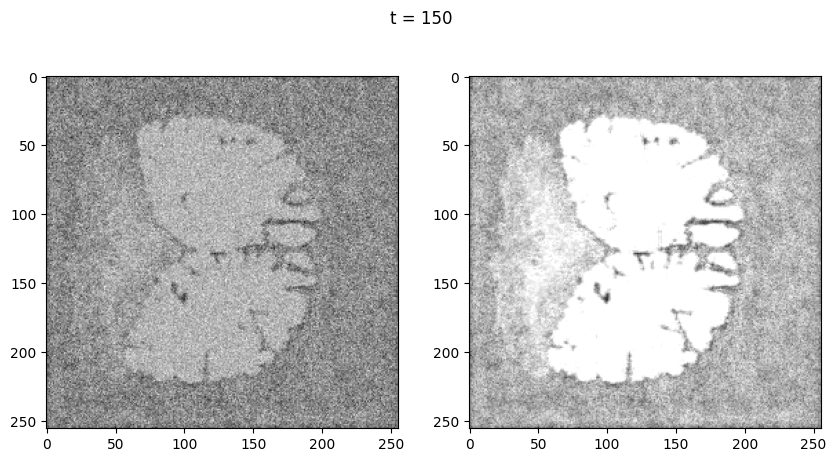

sampling loop time step:  87%|████████▋ | 699/800 [10:19<01:33,  1.08it/s]

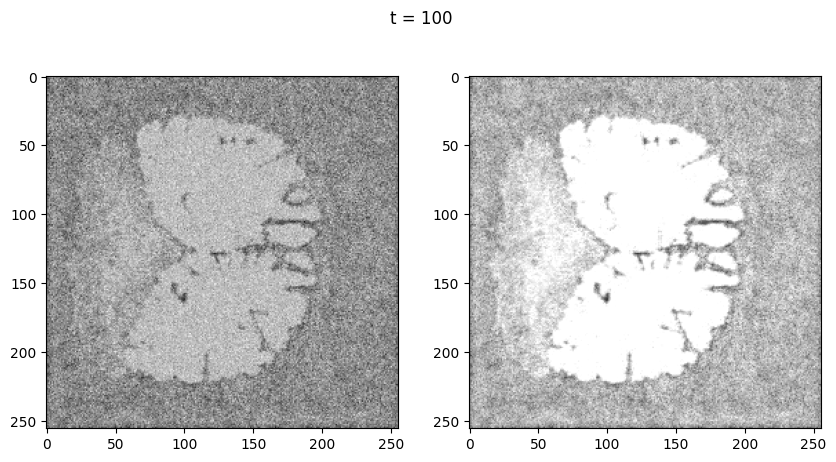

sampling loop time step:  94%|█████████▎| 749/800 [11:11<00:53,  1.06s/it]

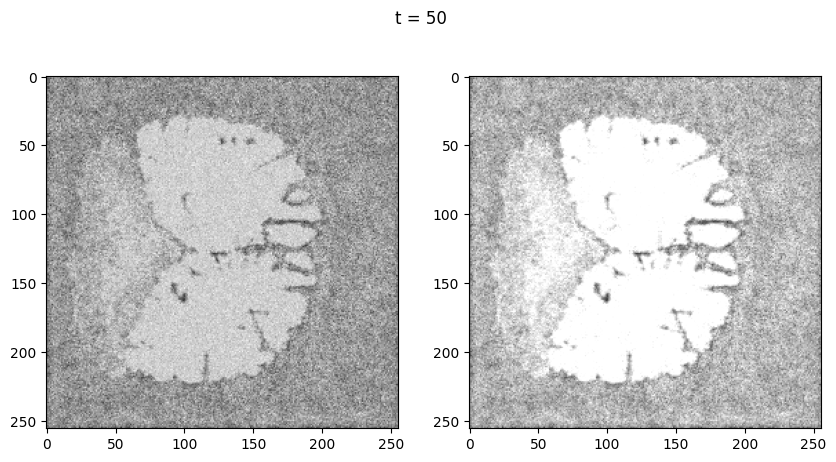

sampling loop time step: 100%|█████████▉| 799/800 [12:02<00:00,  1.01it/s]

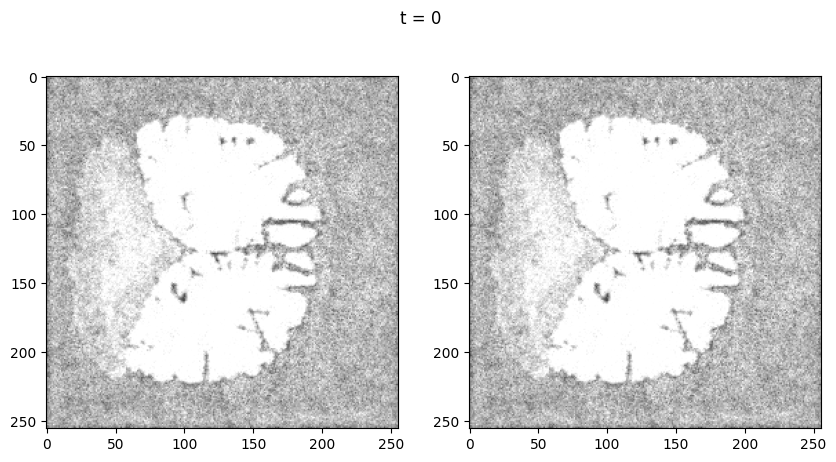

sampling loop time step: 100%|██████████| 800/800 [12:03<00:00,  1.11it/s]


In [95]:
t = 800
plot_every = 50

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)
noised_img = ddpm.q_sample(rand_img, t_tch, noise)

# Plot inputs side by side
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(noised_img.squeeze().numpy(), cmap='gray')
ax[1].imshow(seg, cmap='gray')
plt.suptitle('Noised image and segmentation map (gt)')
plt.show()

img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised, v_est = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img_denoised.squeeze().numpy(), cmap='gray')
        ax[1].imshow(v_est.squeeze().numpy(), cmap='gray')
        plt.suptitle('t = {}'.format(t_i))
        plt.show()

### What does p_mean_variance actually produce?

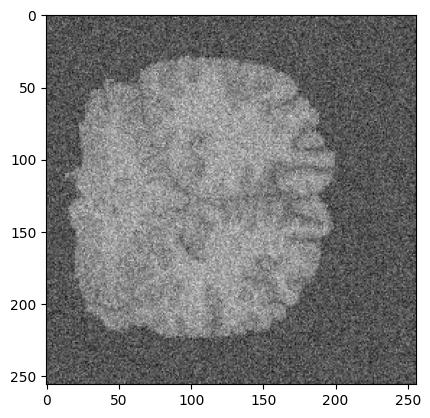

In [102]:
t = 150
t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)
noised_img = ddpm.q_sample(rand_img, t_tch, noise)
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

In [ ]:

model_mean, posterior_variance, posterior_log_variance, x_start = ddpm_ema.model.p_mean_variance(noised_img, t_tch, x_cond)

In [112]:
posterior_variance

tensor([[[[0.0007]]]])

In [110]:
posterior_log_variance.exp()

tensor([[[[0.0007]]]])

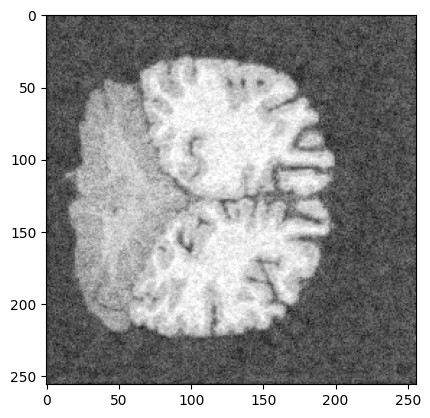

In [108]:
plt.imshow(x_start.squeeze().detach().numpy(), cmap='gray')

## How does DDIM sampling behave?

### When used on smaller noising levels